In [1]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
train_dir = "tf_photos_asmz1/train"
test_dir = "tf_photos_asmz1/test"

train_good_dir = os.path.join(train_dir, 'good')
train_bad_dir = os.path.join(train_dir, 'bad')
test_good_dir  = os.path.join(test_dir, 'good')
test_bad_dir  = os.path.join(test_dir, 'bad')
total_train = len(os.listdir(train_good_dir))+len(os.listdir(train_bad_dir))
total_test = len(os.listdir(test_good_dir)) + len(os.listdir(test_bad_dir))
print("Training Data:",total_train)
print("Testing Data:",total_test)  

Training Data: 982
Testing Data: 407


In [3]:
batch_size = 128
epochs = 5
IMG_HEIGHT = 150
IMG_WIDTH = 150

In [4]:
train_image_generator = ImageDataGenerator(rescale=1./255) # Generator for our training data
validation_image_generator = ImageDataGenerator(rescale=1./255) # Generator for our validation data
train_data_gen = train_image_generator.flow_from_directory(batch_size=batch_size,
                                                           directory=train_dir,
                                                           shuffle=True,
                                                           target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                           class_mode='binary')

Found 982 images belonging to 2 classes.


In [5]:
val_data_gen = validation_image_generator.flow_from_directory(batch_size=batch_size,
                                                              directory=test_dir,
                                                              target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                              class_mode='binary')

Found 407 images belonging to 2 classes.


In [6]:
sample_training_images, _ = next(train_data_gen)
# This function will plot images in the form of a grid with 1 row and 5 columns where images are placed in each column.
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip( images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

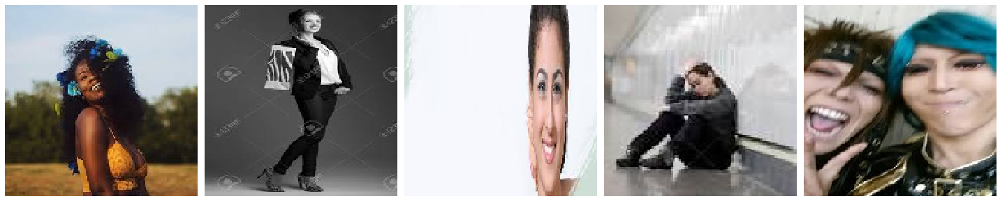

In [7]:
plotImages(sample_training_images[:5])

In [8]:
model = Sequential([
    Conv2D(16, 3, padding='same', activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH ,3)),
    MaxPooling2D(),
    Conv2D(32, 3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(64, 3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(1)
])

In [9]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [10]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 150, 150, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 75, 75, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 75, 75, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 37, 37, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 37, 37, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 18, 18, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 20736)             0

In [11]:
history = model.fit_generator(
    train_data_gen,
    steps_per_epoch=total_train // batch_size,
    epochs=epochs,
    validation_data=val_data_gen,
    validation_steps=total_test // batch_size
)

Epoch 1/5
7/7 [==============================] - 21s 3s/step - loss: 0.9489 - accuracy: 0.4859 - val_loss: 0.6771 - val_accuracy: 0.2708
Epoch 2/5
7/7 [==============================] - 22s 3s/step - loss: 0.6222 - accuracy: 0.4578 - val_loss: 0.5597 - val_accuracy: 0.7318
Epoch 3/5
7/7 [==============================] - 24s 3s/step - loss: 0.5967 - accuracy: 0.7109 - val_loss: 0.5627 - val_accuracy: 0.7474
Epoch 4/5
7/7 [==============================] - 22s 3s/step - loss: 0.5756 - accuracy: 0.7131 - val_loss: 0.5583 - val_accuracy: 0.7396
Epoch 5/5
7/7 [==============================] - 23s 3s/step - loss: 0.5529 - accuracy: 0.7377 - val_loss: 0.5561 - val_accuracy: 0.7188


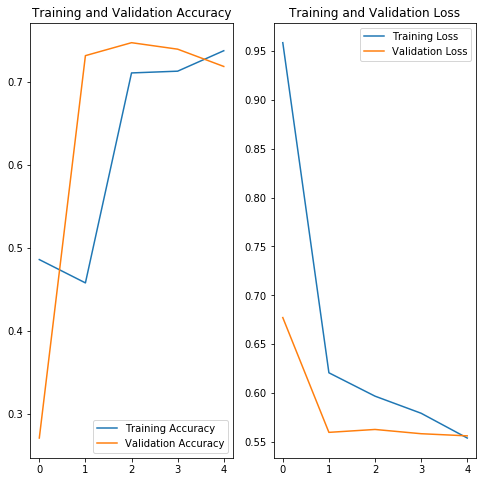

In [12]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [13]:
# save model
model.save('final_model_BC.h5')

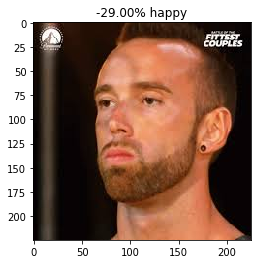

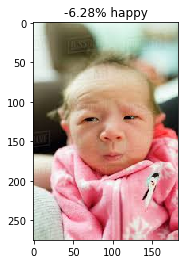

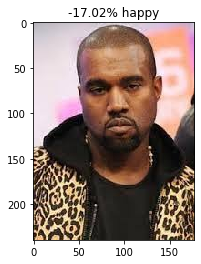

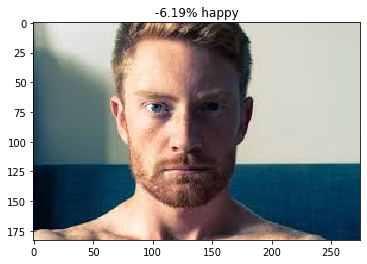

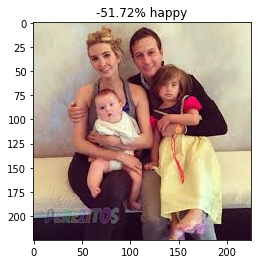

...

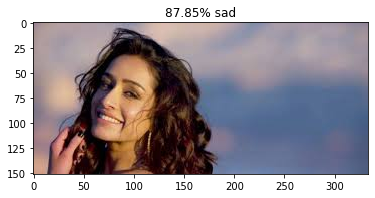

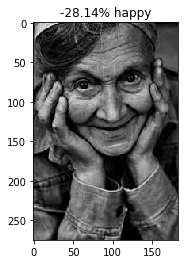

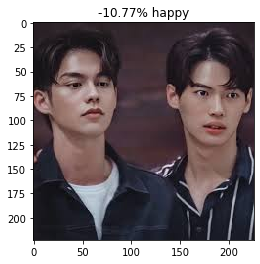

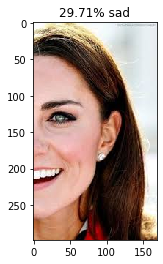

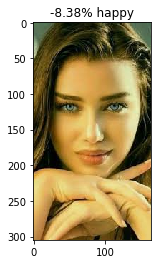

IndexError: list index out of range

In [22]:
TEST_SIZE = 30
import matplotlib.image as mpimg
probabilities = model.predict_generator(val_data_gen, TEST_SIZE)
for index, probability in enumerate(probabilities):
    image_path = test_dir + "/" +val_data_gen.filenames[index]
    img = mpimg.imread(image_path)
    plt.imshow(img)
    if probability < 1:
        plt.title("%.2f" % (probability[0]*100) + "% sad")
    else:
        plt.title("%.2f" % ((1-probability[0])*100) + "% happy")
    plt.show()